# Reinforcement Learning / Tensorflow - TF_Agents 

O Aprendizado por Reforço (RL) é um dos campos do Aprendizado de Máquina  mais antigos. Existe desde a década de 1950, produzindo muitas aplicações interessantes ao longo dos anos. 
<br />
<img src='https://es.mathworks.com/help///reinforcement-learning/ug/reinforcement_learning_diagram.png' width='300' />

*"O aprendizado por reforço difere do aprendizado supervisionado por não precisar de apresentação de pares de entrada / saída rotulados e por não precisar que ações subótimas sejam explicitamente corrigidas. Em vez disso, o foco está em encontrar um equilíbrio entre exploração (de território desconhecido) e exploração (de conhecimento atual)."* [wikipedia](https://en.wikipedia.org/wiki/Reinforcement_learning)



# Setup...
**Aprendendo a jogar River Raid** <br />
<img src='https://s2.glbimg.com/bQhuS5w10e3MAFxzNtnBm_jJNVA=/695x0/s.glbimg.com/po/tt2/f/original/2016/02/26/river-raid-atari-2600-8.jpg' width='300' />
<br />
*"River Raid foi eleito o melhor jogo do ano por diversas revistas. Em 1983 pela InfoWorld, foi chamado de o “videojogo” mais desafiador.[2] Em 1984, a revista The Desert News pontuou: “O mais jogável e divertido game de guerra”.[3] Neste mesmo ano, o jogo recebeu o prêmio de "melhor game de ação do ano"1984"[4]:42 e um certificado de mérito na categoria "1984 Best Computer Action Game" no 5o Arkie Awards"* [Wikipedia](https://pt.wikipedia.org/wiki/River_Raid)

In [1]:
!pip install --upgrade tf-agents
#!pip install  tf-agents
!pip install GPUtil
!pip install gym[atari]
!pip install pyvirtualdisplay
from tensorflow import keras
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import os,sys,humanize,psutil,GPUtil

print("CPU RAM Free: " + humanize.naturalsize( psutil.virtual_memory().available ))
GPUs = GPUtil.getGPUs()
for i, gpu in enumerate(GPUs):
    print('GPU {:d} ... Mem Free: {:.0f}MB / {:.0f}MB | Utilization {:3.0f}%'.format(i, gpu.memoryFree, gpu.memoryTotal, gpu.memoryUtil*100))

mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)
mpl.rc('animation', html='jshtml')

def update_scene(num, frames, patch):
    patch.set_data(frames[num])
    return patch,

def plot_animation(frames, repeat=False, interval=40):
    fig = plt.figure()
    patch = plt.imshow(frames[0])
    plt.axis('off')
    anim = animation.FuncAnimation(
        fig, update_scene, fargs=(frames, patch),
        frames=len(frames), repeat=repeat, interval=interval)
    plt.close()
    return anim
keras.backend.clear_session()


     |████████████████████████████████| 933 kB 4.7 MB/s 
     |████████████████████████████████| 43 kB 1.5 MB/s 
You should consider upgrading via the '/opt/conda/bin/python3.7 -m pip install --upgrade pip' command.
  Created wheel for GPUtil: filename=GPUtil-1.4.0-py3-none-any.whl size=7411 sha256=2c9ad466b3df6e54bb94ff22aa66f954612c950f83b481bd3d49f6bac5cac6b7
  Stored in directory: /root/.cache/pip/wheels/6e/f8/83/534c52482d6da64622ddbf72cd93c35d2ef2881b78fd08ff0c
Successfully built GPUtil
You should consider upgrading via the '/opt/conda/bin/python3.7 -m pip install --upgrade pip' command.
     |████████████████████████████████| 2.8 MB 4.7 MB/s 
You should consider upgrading via the '/opt/conda/bin/python3.7 -m pip install --upgrade pip' command.
You should consider upgrading via the '/opt/conda/bin/python3.7 -m pip install --upgrade pip' command.
CPU RAM Free: 15.5 GB
GPU 0 ... Mem Free: 16280MB / 16280MB | Utilization   0%


# Environment Wrappers and Atari Preprocessing

O TF-Agents disponibliza um wapper para gym para executarmos jogos do atary.
Ele usa por traás o ambiente do OpenAI Gym.
Para enviroment Atari, algums padrões de pré-processamento devem ser aplicados por tanto, TF-Agents fornece o wrapper AtariPreprocessing.
O FrameStack4 retorna pilhas de quadro a quadro.

In [2]:
from tf_agents.environments import  suite_gym
from tf_agents.environments.atari_preprocessing import AtariPreprocessing
from tf_agents.environments.atari_wrappers import FrameStack4

In [3]:
#Carregando - River raid
env = suite_gym.load(environment_name="RiverraidNoFrameskip-v4",max_episode_steps=27000, gym_env_wrappers=[AtariPreprocessing,FrameStack4])

Exibindo ambiente

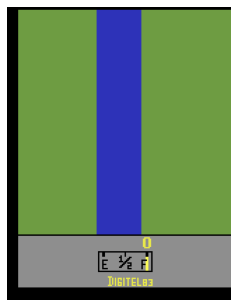

In [4]:
env.reset()
img = env.render(mode="rgb_array")
plt.figure(figsize=(4, 6))
plt.imshow(img)
plt.axis("off")
plt.show()

# Environment Specifications
O TF-Agents fornces as especificações das observações, ações e etapas incluindo seus respectivos shapes.

In [5]:
print('Ações disponíveis:\n{}\r\n'.format(env.gym.get_action_meanings()))
print('Observação:\n{}'.format(env.observation_spec()))

Ações disponíveis:
['NOOP', 'FIRE', 'UP', 'RIGHT', 'LEFT', 'DOWN', 'UPRIGHT', 'UPLEFT', 'DOWNRIGHT', 'DOWNLEFT', 'UPFIRE', 'RIGHTFIRE', 'LEFTFIRE', 'DOWNFIRE', 'UPRIGHTFIRE', 'UPLEFTFIRE', 'DOWNRIGHTFIRE', 'DOWNLEFTFIRE']

Observação:
BoundedArraySpec(shape=(84, 84, 4), dtype=dtype('uint8'), name='observation', minimum=0, maximum=255)


# Environment Wrappers



In [6]:
#Aqui está a lista de wrappers disponíveis:
import tf_agents.environments.wrappers

for name in dir(tf_agents.environments.wrappers):
    obj = getattr(tf_agents.environments.wrappers, name)
    if hasattr(obj, "__base__") and issubclass(obj, tf_agents.environments.wrappers.PyEnvironmentBaseWrapper):
        print("{:27s} {}".format(name, obj.__doc__.split("\n")[0]))

ActionClipWrapper           Wraps an environment and clips actions to spec before applying.
ActionDiscretizeWrapper     Wraps an environment with continuous actions and discretizes them.
ActionOffsetWrapper         Offsets actions to be zero-based.
ActionRepeat                Repeates actions over n-steps while acummulating the received reward.
FlattenObservationsWrapper  Wraps an environment and flattens nested multi-dimensional observations.
GoalReplayEnvWrapper        Adds a goal to the observation, used for HER (Hindsight Experience Replay).
HistoryWrapper              Adds observation and action history to the environment's observations.
ObservationFilterWrapper    Filters observations based on an array of indexes.
OneHotActionWrapper         Converts discrete action to one_hot format.
PerformanceProfiler         End episodes after specified number of steps.
PyEnvironmentBaseWrapper    PyEnvironment wrapper forwards calls to the given environment.
RunStats                    Wrapp

(-0.5, 83.5, 83.5, -0.5)

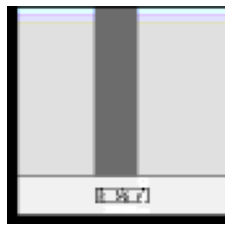

In [7]:
#Vamos executar alguns comandos para ver o que está acontecendo dentro do enviroment.
env.reset()
time_step = env.step(np.array(1)) # FIRE
time_step = env.step(np.array(3)) # RIGHT
time_step = env.step(np.array(8)) # DOWNRIGHT

observation = time_step.observation.astype(np.float32)
#Como existem apenas 3 canais de cores, você não pode exibir 4 frames.
image = observation[..., :3]
image = np.clip(image / 150, 0, 1)
plt.imshow(image)
plt.axis("off")

Para agruparmoss o ambiente, usamos o TFPyEnviroment

In [8]:
from tf_agents.environments.tf_py_environment import TFPyEnvironment
tf_env = TFPyEnvironment(env)

# DQN
O TF-Agents, fornece alguns pacotes de redes.
Nesse pacote, as imagens são armazenadas usando bytes de 0 a 255 para usar menos RAM.

O QNetwork usa um observation_spec como entrada e gera um Q-Value de ação.



In [9]:
from tf_agents.networks.q_network import QNetwork
#converter as observações em float 32, os normalizando.. (valores  0.0 a 1.0) 
preprocessing_layer = keras.layers.Lambda( lambda obs: tf.cast(obs, np.float32) / 255.)

#Três redes neurais convolucionais simples, 64 filtros, seus respectiveis kernels e strides.
#conv_layer_params=[(32, (8, 8), 4), (64, (4, 4), 2), (64, (3, 3), 1)]
conv_layer_params=[(32, (8, 8), 4) , (64, (4, 4), 2)]#, (64, (3, 3), 1), (1024, (7, 7), 1)]
#Uma dense layer com 512 por uma cama de sair de 4 unidades
fc_layer_params=(1024,)

q_network = QNetwork(tf_env.observation_spec(), tf_env.action_spec()
                     ,preprocessing_layers=preprocessing_layer
                     ,conv_layer_params=conv_layer_params
                     ,fc_layer_params=fc_layer_params)
q_network.summary

<bound method Network.summary of <tf_agents.networks.q_network.QNetwork object at 0x7f490a7f31d0>>

# DQN Agent
[DQN paper ](https://web.stanford.edu/class/psych209/Readings/MnihEtAlHassibis15NatureControlDeepRL.pdf)  

In [10]:
from tf_agents.agents.dqn.dqn_agent import DqnAgent

train_step = tf.Variable(0)
update_period = 4 
#optimizer = keras.optimizers.Adam(lr=2.5e-4, rho=0.95, momentum=0.1,epsilon=0.00001, centered=True)
optimizer = tf.compat.v1.train.RMSPropOptimizer(learning_rate=2.5e-4, decay=0.95, momentum=0.0,
                                     epsilon=0.00001, centered=True)
#optimizer = keras.optimizers.Adam(lr=0.00005,epsilon=0.00001)
epsilon_fn = keras.optimizers.schedules.PolynomialDecay(
    initial_learning_rate=0.8,
    decay_steps=250000 // update_period, 
    end_learning_rate=0.01)

agent = DqnAgent(tf_env.time_step_spec(),
                 tf_env.action_spec(),
                 q_network=q_network,
                 optimizer=optimizer,
                 target_update_period=2000, 
                 #A função de perda  deve retornar um erro por instancia, por isso definimos  reduction="none" 
                 td_errors_loss_fn=keras.losses.Huber(reduction="none"),
                 gamma=0.89, # discount factor
                 train_step_counter=train_step,
                 epsilon_greedy=lambda: epsilon_fn(train_step))
agent.initialize()

# Replay Buffer and the Corresponding Observer
O TF-Agents libary disponibiliza algumas implementações de buffer de reprodução no pacote tf_agents.replay_buffers.

**max_length:** Valor ideia é 1000000


In [11]:
from tf_agents.replay_buffers import tf_uniform_replay_buffer

#data_spec é a especificação dos dados que serão salvos no buffer. 
#batch_size è o numero de trajeroias que devem ser adicionadas a cada etapa.
#max_length é o tamanho máximo de reprodução. (Paper DQN2015: cuidado com o devorador de RAM)

replay_buffer = tf_uniform_replay_buffer.TFUniformReplayBuffer( data_spec=agent.collect_data_spec,    batch_size=tf_env.batch_size, max_length=300000)

replay_buffer_observer = replay_buffer.add_batch

# Training Metrics
Usando as várias metricas do pacote  tf_agents.metrics.



In [12]:
from tf_agents.metrics import tf_metrics
from tf_agents.eval.metric_utils import log_metrics
import logging
train_metrics = [
    tf_metrics.NumberOfEpisodes(),
    tf_metrics.EnvironmentSteps(),
    tf_metrics.AverageReturnMetric(),
    tf_metrics.AverageEpisodeLengthMetric(),
]
logging.getLogger().setLevel(logging.INFO)
log_metrics(train_metrics)

# Collect Driver
Um driver é um objseto que explora um enviroment usando policy, ele colecta as experiencias de cada etapa de treinamento e as transmite aos observadores.

In [13]:
from tf_agents.drivers.dynamic_step_driver import DynamicStepDriver

collect_driver = DynamicStepDriver(
    tf_env,
    agent.collect_policy,
    observers=[replay_buffer_observer] + train_metrics,
    num_steps=update_period) 
collect_driver

In [14]:
from tf_agents.policies.random_tf_policy import RandomTFPolicy

class ShowProgress:
    def __init__(self, total):
        self.counter = 0
        self.total = total
    def __call__(self, trajectory):
        if not trajectory.is_boundary():
            self.counter += 1
        if self.counter % 100 == 0:
            print("\r{}/{}".format(self.counter, self.total), end="")

initial_collect_policy = RandomTFPolicy(tf_env.time_step_spec(),
                                        tf_env.action_spec())
init_driver = DynamicStepDriver(
    tf_env,
    initial_collect_policy,
    observers=[replay_buffer.add_batch, ShowProgress(20000)],
    num_steps=20000)
final_time_step, final_policy_state = init_driver.run()

20000/20000

In [15]:
#Exemplo de trajetoria final de um episodio
trajectories, buffer_info = replay_buffer.get_next(sample_batch_size=2, num_steps=17)
trajectories, buffer_info, trajectories._fields

(Trajectory(step_type=<tf.Tensor: shape=(2, 17), dtype=int32, numpy=
 array([[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
        [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]], dtype=int32)>, observation=<tf.Tensor: shape=(2, 17, 84, 84, 4), dtype=uint8, numpy=
 array([[[[[  0,   0,   0,   0],
           [  0,   0,   0,   0],
           [  0,   0,   0,   0],
           ...,
           [ 26,  26,  26,  26],
           [ 26,  26,  26,  26],
           [ 26,  26,  26,  26]],
 
          [[  0,   0,   0,   0],
           [  0,   0,   0,   0],
           [  0,   0,   0,   0],
           ...,
           [132, 132, 132, 132],
           [132, 132, 132, 132],
           [132, 132, 132, 132]],
 
          [[  0,   0,   0,   0],
           [  0,   0,   0,   0],
           [  0,   0,   0,   0],
           ...,
           [132, 132, 132, 132],
           [132, 132, 132, 132],
           [132, 132, 132, 132]],
 
          ...,
 
          [[  0,   0,   0,   0],
           [  0,   0, 

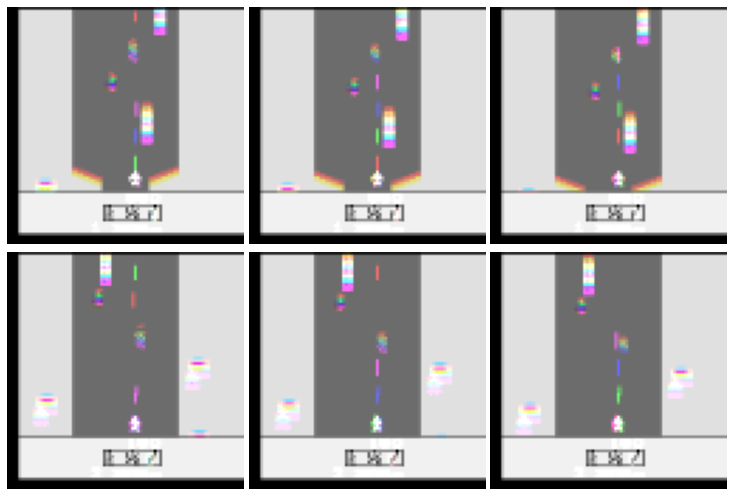

In [16]:
from tf_agents.trajectories.trajectory import to_transition

time_steps, action_steps, next_time_steps = to_transition(trajectories)
time_steps.observation.shape,trajectories.step_type.numpy()


plt.figure(figsize=(10, 6.8))
for row in range(2):
    for col in range(3):
        plt.subplot(2, 3, row * 3 + col + 1)
        obs = trajectories.observation[row, col].numpy().astype(np.float32)
        img = obs[..., :3]
        current_frame_delta = np.maximum(obs[..., 3] - obs[..., :3].mean(axis=-1), 0.)
        img[..., 0] += current_frame_delta
        img[..., 2] += current_frame_delta
        img = np.clip(img / 150, 0, 1)
        plt.imshow(img)
        plt.axis("off")
plt.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0, wspace=0.02)
plt.show()

# Dataset
converter os dados do buffer em um dataset para nosso treinamento

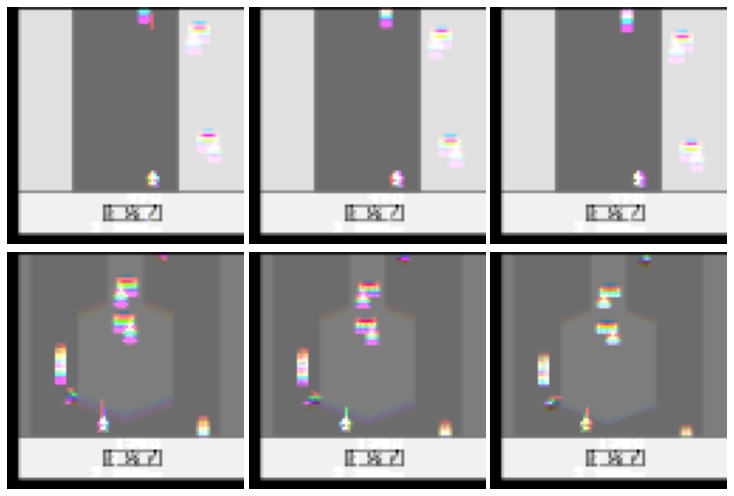

In [17]:
dataset = replay_buffer.as_dataset(
    sample_batch_size=64,
    num_steps=17,
    num_parallel_calls=3
).prefetch(3)
iterator = iter(dataset)
trajectories, buffer_info = next(iterator)
plt.figure(figsize=(10, 6.8))
for row in range(2):
    for col in range(3):
        plt.subplot(2, 3, row * 3 + col + 1)
        obs = trajectories.observation[row, col].numpy().astype(np.float32)
        img = obs[..., :3]
        current_frame_delta = np.maximum(obs[..., 3] - obs[..., :3].mean(axis=-1), 0.)
        img[..., 0] += current_frame_delta
        img[..., 2] += current_frame_delta
        img = np.clip(img / 150, 0, 1)
        plt.imshow(img)
        plt.axis("off")
plt.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0, wspace=0.02)
plt.show()


In [18]:
dataset = replay_buffer.as_dataset(
    sample_batch_size=64,
    num_steps=2,
    num_parallel_calls=3).prefetch(3)

# Training Loop

In [19]:
#Converter funções.
from tf_agents.utils.common import function

collect_driver.run = function(collect_driver.run)
agent.train = function(agent.train)

In [20]:

def train_agent(n_iterations):
    time_step = None
    policy_state = agent.collect_policy.get_initial_state(tf_env.batch_size)
    iterator = iter(dataset)
    for iteration in range(n_iterations):
        time_step, policy_state = collect_driver.run(time_step, policy_state)
        trajectories, buffer_info = next(iterator)
        train_loss = agent.train(trajectories)
        print("\r{} loss: {:.5f}".format(
            iteration, train_loss.loss.numpy()), end="")
        if iteration % 1000 == 0:
            log_metrics(train_metrics)

In [21]:
# o valor ideal para n_iterations  é 1.000.000 
train_agent(n_iterations=900000)

897113 loss: 1.59837

# Visualization

In [22]:
frames = []
def save_frames(trajectory):
    global frames
    frames.append(tf_env.pyenv.envs[0].render(mode="rgb_array"))

prev_lives = tf_env.pyenv.envs[0].ale.lives()
def reset_and_fire_on_life_lost(trajectory):
    global prev_lives
    lives = tf_env.pyenv.envs[0].ale.lives()
    if prev_lives != lives:
        tf_env.reset()
        tf_env.pyenv.envs[0].step(np.array(tf_env.pyenv.envs[0].action_space.sample()))
        prev_lives = lives

watch_driver = DynamicStepDriver(
    tf_env,
    agent.policy,
    observers=[save_frames, reset_and_fire_on_life_lost, ShowProgress(10000)],
    num_steps=10000)
final_time_step, final_policy_state = watch_driver.run()

plot_animation(frames)


10000/10000

In [23]:
#Criando um Gif
import PIL

image_path = os.path.join("view1.gif")
frame_images = [PIL.Image.fromarray(frame) for frame in frames[:150]]
frame_images[0].save(image_path, format='GIF',
                     append_images=frame_images[1:],
                     save_all=True,
                     duration=300,
                     loop=0)

In [24]:
%%html
<img src="view1.gif" />

<img src="https://i.pinimg.com/originals/41/7d/33/417d33d3f0aa7be41e9495f845930209.gif" />

# Referencies
[Hands–On Machine Learning with Scikit–Learn and TensorFlow 2](https://www.amazon.com.br/Hands-Machine-Learning-Scikit-Learn-TensorFlow/dp/1492032646)

[Agents is a library for reinforcement learning in TensorFlow.
](https://www.tensorflow.org/agents)

[Introduction to TF-Agents : A library for Reinforcement Learning in TensorFlow](https://towardsdatascience.com/introduction-to-tf-agents-a-library-for-reinforcement-learning-in-tensorflow-68ab9add6ad6)

[Train a Deep Q Network with TF-Agents](https://www.tensorflow.org/agents/tutorials/1_dqn_tutorial)



